In [ ]:
import folium
import geopandas as gpd
import h3
import xyzservices.providers as xyz
from h3pandas import *
from shapely.geometry import Polygon


def add_geometry(row):
    """create hex geometry"""
    points = h3.h3_to_geo_boundary(row["h3_polyfill"], True)
    return Polygon(points)

In [5]:
bp = gpd.read_file("data/budapest.geojson")

In [8]:
result = {}
for res in range(7, 11):
    h = bp.h3.polyfill(res, explode=True)

    h["geometry_hex"] = h.apply(add_geometry, axis=1)
    h.drop("geometry", axis=1, inplace=True)
    h.rename({"geometry_hex": "geometry"}, axis=1, inplace=True)
    h.set_geometry("geometry", inplace=True)
    h.set_crs(4326, inplace=True)
    # h.to_crs(23700, inplace=True)
    result[res] = h

<Axes: >

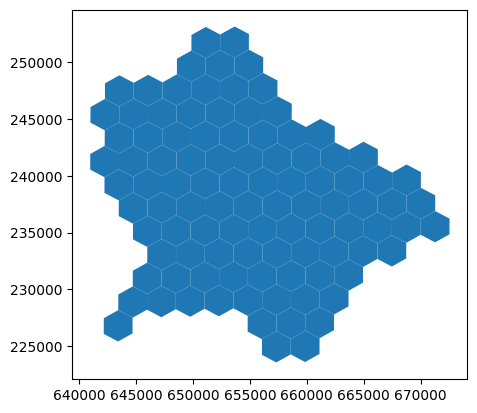

In [51]:
result[7].plot()

In [ ]:
colors = ["#41afaa", "#466eb4", "#00a0e1", "#e6a532", "#d7642c", "#af4b91"]

In [36]:
m = folium.Map(
    location=[
        sum(result[7].geometry.total_bounds[[1, 3]]) / 2,
        sum(result[7].geometry.total_bounds[[0, 2]]) / 2,
    ],
    zoom_start=12,
    tiles=xyz.CartoDB.Voyager,
    control_scale=True,
    control=True,
)

folium.GeoJson(
    result[7].__geo_interface__,
    style_function=lambda x: {
        # "color": "#ef007b",
        "color": colors[4],
    },
    name="H3-7",
    show=False,
    # tooltip=folium.features.GeoJsonTooltip(["id", "values"]),
).add_to(m)

folium.GeoJson(
    result[8].__geo_interface__,
    style_function=lambda x: {
        "color": colors[1],
    },
    name="H3-8",
).add_to(m)

folium.GeoJson(
    result[9].__geo_interface__,
    style_function=lambda x: {
        "color": colors[3],
    },
    name="H3-9",
).add_to(m)

folium.GeoJson(
    result[10].__geo_interface__,
    style_function=lambda x: {
        "color": colors[5],
    },
    name="H3-10",
    show=False,
).add_to(m)
folium.LayerControl().add_to(m)
m

In [ ]:
m.save("docs/index.html")